In [1]:
# install the modules
import sys

if all([module in sys.modules for module in ['pandas', 'plotly', 'sklearn', 'scipy', 'netCDF4', 'hdbscan', 'cv2']]):
    print("Modules already installed")
else:
    %pip install pandas
    %pip install plotly
    %pip install scikit-learn
    %pip install scipy
    %pip install netCDF4
    %pip install hdbscan
    %pip install opencv-python

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [46]:
import plotly.graph_objects as go
import pandas as pd

# Sample DataFrame
df = pd.DataFrame({
    'lat': [40.7128, 34.0522, 37.7749],
    'lon': [-74.0060, -118.2437, -122.4194],
    'value': [10, 20, 30]
})

# Create a Scattermapbox trace for the satellite map
fig = go.Figure(go.Scattermapbox(
    mode="markers+text",
    lon=df['lon'],
    lat=df['lat'],
    text=df['value'].astype(str),
    marker=go.scattermapbox.Marker(
        size=10,
        color='rgb(255, 0, 0)',
        opacity=0.7,
    ),
    textposition='top center'
))

# Define the square shapes
shapes = []
for index, row in df.iterrows():
    shapes.append(
        dict(
            type="rect",
            lon=dict(range=[row['lon'] - 0.5, row['lon'] + 0.5]),
            lat=dict(range=[row['lat'] - 0.5, row['lat'] + 0.5]),
            line=dict(color="rgba(0, 0, 0, 0)"),
            fillcolor="rgba(255, 0, 0, 0.5)"
        )
    )

# Add the square shapes to the figure
fig.update_layout(
    shapes=shapes
)

# Update layout to show map centered around mean lat/lon and adjust zoom
fig.update_layout(
    mapbox=dict(
        center=dict(
            lat=df['lat'].mean(),
            lon=df['lon'].mean()
        ),
        zoom=3,
        style="satellite"
    )
)

fig.show()


ValueError: Invalid property specified for object of type plotly.graph_objs.layout.Shape: 'x'

Did you mean "x0"?

    Valid properties:
        editable
            Determines whether the shape could be activated for
            edit or not. Has no effect when the older editable
            shapes mode is enabled via `config.editable` or
            `config.edits.shapePosition`.
        fillcolor
            Sets the color filling the shape's interior. Only
            applies to closed shapes.
        fillrule
            Determines which regions of complex paths constitute
            the interior. For more info please visit
            https://developer.mozilla.org/en-
            US/docs/Web/SVG/Attribute/fill-rule
        label
            :class:`plotly.graph_objects.layout.shape.Label`
            instance or dict with compatible properties
        layer
            Specifies whether shapes are drawn below or above
            traces.
        line
            :class:`plotly.graph_objects.layout.shape.Line`
            instance or dict with compatible properties
        name
            When used in a template, named items are created in the
            output figure in addition to any items the figure
            already has in this array. You can modify these items
            in the output figure by making your own item with
            `templateitemname` matching this `name` alongside your
            modifications (including `visible: false` or `enabled:
            false` to hide it). Has no effect outside of a
            template.
        opacity
            Sets the opacity of the shape.
        path
            For `type` "path" - a valid SVG path with the pixel
            values replaced by data values in
            `xsizemode`/`ysizemode` being "scaled" and taken
            unmodified as pixels relative to `xanchor` and
            `yanchor` in case of "pixel" size mode. There are a few
            restrictions / quirks only absolute instructions, not
            relative. So the allowed segments are: M, L, H, V, Q,
            C, T, S, and Z arcs (A) are not allowed because radius
            rx and ry are relative. In the future we could consider
            supporting relative commands, but we would have to
            decide on how to handle date and log axes. Note that
            even as is, Q and C Bezier paths that are smooth on
            linear axes may not be smooth on log, and vice versa.
            no chained "polybezier" commands - specify the segment
            type for each one. On category axes, values are numbers
            scaled to the serial numbers of categories because
            using the categories themselves there would be no way
            to describe fractional positions On data axes: because
            space and T are both normal components of path strings,
            we can't use either to separate date from time parts.
            Therefore we'll use underscore for this purpose:
            2015-02-21_13:45:56.789
        templateitemname
            Used to refer to a named item in this array in the
            template. Named items from the template will be created
            even without a matching item in the input figure, but
            you can modify one by making an item with
            `templateitemname` matching its `name`, alongside your
            modifications (including `visible: false` or `enabled:
            false` to hide it). If there is no template or no
            matching item, this item will be hidden unless you
            explicitly show it with `visible: true`.
        type
            Specifies the shape type to be drawn. If "line", a line
            is drawn from (`x0`,`y0`) to (`x1`,`y1`) with respect
            to the axes' sizing mode. If "circle", a circle is
            drawn from ((`x0`+`x1`)/2, (`y0`+`y1`)/2)) with radius
            (|(`x0`+`x1`)/2 - `x0`|, |(`y0`+`y1`)/2 -`y0`)|) with
            respect to the axes' sizing mode. If "rect", a
            rectangle is drawn linking (`x0`,`y0`), (`x1`,`y0`),
            (`x1`,`y1`), (`x0`,`y1`), (`x0`,`y0`) with respect to
            the axes' sizing mode. If "path", draw a custom SVG
            path using `path`. with respect to the axes' sizing
            mode.
        visible
            Determines whether or not this shape is visible.
        x0
            Sets the shape's starting x position. See `type` and
            `xsizemode` for more info.
        x1
            Sets the shape's end x position. See `type` and
            `xsizemode` for more info.
        xanchor
            Only relevant in conjunction with `xsizemode` set to
            "pixel". Specifies the anchor point on the x axis to
            which `x0`, `x1` and x coordinates within `path` are
            relative to. E.g. useful to attach a pixel sized shape
            to a certain data value. No effect when `xsizemode` not
            set to "pixel".
        xref
            Sets the shape's x coordinate axis. If set to a x axis
            id (e.g. "x" or "x2"), the `x` position refers to a x
            coordinate. If set to "paper", the `x` position refers
            to the distance from the left of the plotting area in
            normalized coordinates where 0 (1) corresponds to the
            left (right). If set to a x axis ID followed by
            "domain" (separated by a space), the position behaves
            like for "paper", but refers to the distance in
            fractions of the domain length from the left of the
            domain of that axis: e.g., *x2 domain* refers to the
            domain of the second x  axis and a x position of 0.5
            refers to the point between the left and the right of
            the domain of the second x axis.
        xsizemode
            Sets the shapes's sizing mode along the x axis. If set
            to "scaled", `x0`, `x1` and x coordinates within `path`
            refer to data values on the x axis or a fraction of the
            plot area's width (`xref` set to "paper"). If set to
            "pixel", `xanchor` specifies the x position in terms of
            data or plot fraction but `x0`, `x1` and x coordinates
            within `path` are pixels relative to `xanchor`. This
            way, the shape can have a fixed width while maintaining
            a position relative to data or plot fraction.
        y0
            Sets the shape's starting y position. See `type` and
            `ysizemode` for more info.
        y1
            Sets the shape's end y position. See `type` and
            `ysizemode` for more info.
        yanchor
            Only relevant in conjunction with `ysizemode` set to
            "pixel". Specifies the anchor point on the y axis to
            which `y0`, `y1` and y coordinates within `path` are
            relative to. E.g. useful to attach a pixel sized shape
            to a certain data value. No effect when `ysizemode` not
            set to "pixel".
        yref
            Sets the shape's y coordinate axis. If set to a y axis
            id (e.g. "y" or "y2"), the `y` position refers to a y
            coordinate. If set to "paper", the `y` position refers
            to the distance from the bottom of the plotting area in
            normalized coordinates where 0 (1) corresponds to the
            bottom (top). If set to a y axis ID followed by
            "domain" (separated by a space), the position behaves
            like for "paper", but refers to the distance in
            fractions of the domain length from the bottom of the
            domain of that axis: e.g., *y2 domain* refers to the
            domain of the second y  axis and a y position of 0.5
            refers to the point between the bottom and the top of
            the domain of the second y axis.
        ysizemode
            Sets the shapes's sizing mode along the y axis. If set
            to "scaled", `y0`, `y1` and y coordinates within `path`
            refer to data values on the y axis or a fraction of the
            plot area's height (`yref` set to "paper"). If set to
            "pixel", `yanchor` specifies the y position in terms of
            data or plot fraction but `y0`, `y1` and y coordinates
            within `path` are pixels relative to `yanchor`. This
            way, the shape can have a fixed height while
            maintaining a position relative to data or plot
            fraction.
        
Did you mean "x0"?

Bad property path:
x
^

In [ ]:
df['BRD']

In [38]:
%pip install dash

     ---------------------------------------- 0.0/10.2 MB ? eta -:--:--
     -- ------------------------------------- 0.7/10.2 MB 15.0 MB/s eta 0:00:01
     ------ --------------------------------- 1.5/10.2 MB 16.2 MB/s eta 0:00:01
     ----------- ---------------------------- 2.9/10.2 MB 20.6 MB/s eta 0:00:01
     ----------------- ---------------------- 4.4/10.2 MB 23.4 MB/s eta 0:00:01
     --------------------- ------------------ 5.5/10.2 MB 23.5 MB/s eta 0:00:01
     --------------------------- ------------ 7.0/10.2 MB 24.9 MB/s eta 0:00:01
     ------------------------------- -------- 8.1/10.2 MB 25.8 MB/s eta 0:00:01
     ------------------------------------ --- 9.4/10.2 MB 25.1 MB/s eta 0:00:01
     --------------------------------------  10.2/10.2 MB 25.1 MB/s eta 0:00:01
     --------------------------------------- 10.2/10.2 MB 23.3 MB/s eta 0:00:00
     ---------------------------------------- 0.0/101.3 kB ? eta -:--:--
     -------------------------------------- 101.3/101.3

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorboard 2.11.2 requires protobuf<4,>=3.9.2, but you have protobuf 4.25.3 which is incompatible.


In [2]:
# necessary imports
import netCDF4 as nc
from os import chdir # to alter your working directory

import math
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
import plotly.graph_objects as go

from sklearn.cluster import KMeans
import hdbscan

import cv2

In [3]:
import sys
# we need to mount the drive if we are using google colab
if 'google.colab' in sys.modules:
    # mount on drive
    from google.colab import drive
    drive.mount('/content/drive')
    chdir('/content/drive/MyDrive/TT_satellite_images/data')

In [4]:
""" We choose what type of land we use to do the classification. Can be 'sea', 'land' or 'all' """

selection = 'land'  # land selection
fill_value = -1000  # fill values for non available data

file_path = "data/GRASP_POLDER_L3_climatological_S1.1degree.nc"
original_dataset = nc.Dataset(file_path)
img_shape = original_dataset.variables['DHR1020'][:].shape # we will use this to flatten the variables and get the shape back later

# mask creation, to select the land or the sea or both
if selection == 'sea':
  mask = (original_dataset.variables['LandPercentage'][:] == 100).filled(True)
elif selection == 'land':
  mask = (original_dataset.variables['LandPercentage'][:] != 100).filled(True)
else:
  mask = original_dataset.variables['DHR1020'][:].mask

# flattening the variables / masking
data = {}
for var in original_dataset.variables:
  if original_dataset[var][:].shape == img_shape: # we only want the variables with the same shape as the image
    data[var] = original_dataset[var][:].flatten()
    data[var][mask.flatten()] = fill_value

# creating the dataframe
df = pd.DataFrame(data)
#del data, original_dataset # free some memory

# we explicitly set the fill_value to nan
df = df.replace(fill_value, np.nan)

df # we can use the google colab tools to visualize the distributions

,AAOD1020,AAOD443,AAOD490,AAOD565,AAOD670,AAOD865,AExp,AOD1020,AOD443,AOD490,...,Soot_Fraction_C,Soot_Fraction_F,Soot_Volume_Concentration_C,Soot_Volume_Concentration_F,SphereFraction,VertProfileHeight,Water_Fraction_C,Water_Fraction_F,Water_Volume_Concentration_C,Water_Volume_Concentration_F
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64795,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
64796,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
64797,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
64798,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
# a function to get the flattened arrays back to the original shape
def get_original_shape(arr):
  return arr.to_numpy().reshape(img_shape)

# display the variables of the dataframe
from utils import display_variables
display_variables(df)

Category,Variables
SizeDistrLogNormBin,"SizeDistrLogNormBin1, SizeDistrLogNormBin2, SizeDistrLogNormBin3, SizeDistrLogNormBin4, SizeDistrLogNormBin5"
SSA,"SSA1020, SSA443, SSA490, SSA565, SSA670, SSA865, SSAC1020, SSAC443, SSAC490, SSAC565, SSAC670, SSAC865, SSAF1020, SSAF443, SSAF490, SSAF565, SSAF670, SSAF865"
Ross Parameters,"Ross_Li_BRDF_1020_isotropic_parameter, Ross_Li_BRDF_443_isotropic_parameter, Ross_Li_BRDF_490_isotropic_parameter, Ross_Li_BRDF_565_isotropic_parameter, Ross_Li_BRDF_670_geometric_parameter, Ross_Li_BRDF_670_isotropic_parameter, Ross_Li_BRDF_670_volumetric_parameter, Ross_Li_BRDF_865_isotropic_parameter"
Soluble Fraction,"Soluble_Fraction_C, Soluble_Fraction_F"
Soluble Volume Concentration,"Soluble_Volume_Concentration_C, Soluble_Volume_Concentration_F"
Water Fraction,"Water_Fraction_C, Water_Fraction_F"
Water Volume Concentration,"Water_Volume_Concentration_C, Water_Volume_Concentration_F"
Land parameters,"LandBPDFMaignanBreon670, LandPercentage"
Reflection indices (?),"RealRefIndC1020, RealRefIndC443, RealRefIndC490, RealRefIndC565, RealRefIndC670, RealRefIndC865, RealRefIndF1020, RealRefIndF443, RealRefIndF490, RealRefIndF565, RealRefIndF670, RealRefIndF865"
Cox Munk Parameters,"Cox_Munk_iso_BRM_1020_first_parameter, Cox_Munk_iso_BRM_443_first_parameter, Cox_Munk_iso_BRM_490_first_parameter, Cox_Munk_iso_BRM_565_first_parameter, Cox_Munk_iso_BRM_670_first_parameter, Cox_Munk_iso_BRM_670_second_parameter, Cox_Munk_iso_BRM_670_third_parameter, Cox_Munk_iso_BRM_865_first_parameter"


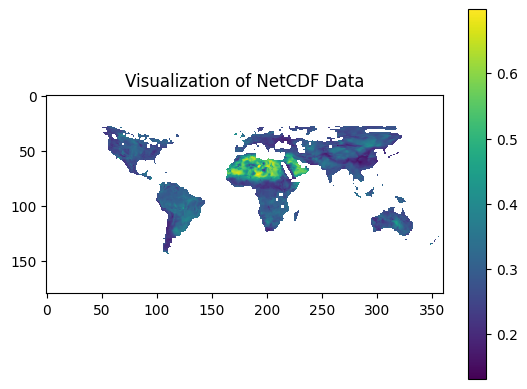

In [6]:
import numpy.ma as ma
# Plot variables
im = get_original_shape(df['DHR1020'])
plt.figure()
plt.imshow(im, cmap='viridis')  #
plt.colorbar()
plt.title('Visualization of NetCDF Data')
plt.show()

In [7]:
from utils import plot_variable, show_results
plot_variable(df, 'DHR1020')

## 1. k-means land-type classification

In [8]:
# Clustering parameters

DHR_variables = ['DHR1020', 'DHR443', 'DHR490', 'DHR565', 'DHR670', 'DHR865']

clustering_variables = DHR_variables + ['NDVI'] # Define the variables used for clustering
clustering_variables = ['Ross_Li_BRDF_670_geometric_parameter', 'DHR670', 'SSA670', 'AAOD670', 'AODF1020', 'AExp', 'NDVI']
clustering_variables = ['Water_Fraction_C', 'BrC_Fraction_C', 'Insoluble_Fraction_C', 'Iron_Fraction_C', 'NDVI']

num_clusters = 10   # Define the number of clusters

### 1.1 Plot classification

In [31]:
def normalize(data):
  return (data - data.mean()) / data.std()

data = df[['NDVI',]]
data = normalize(data)

# Apply K-means clustering

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(data.fillna(-1000))
labels = kmeans.labels_

c:\Users\Mathis\.conda\envs\ProjetTunnel\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



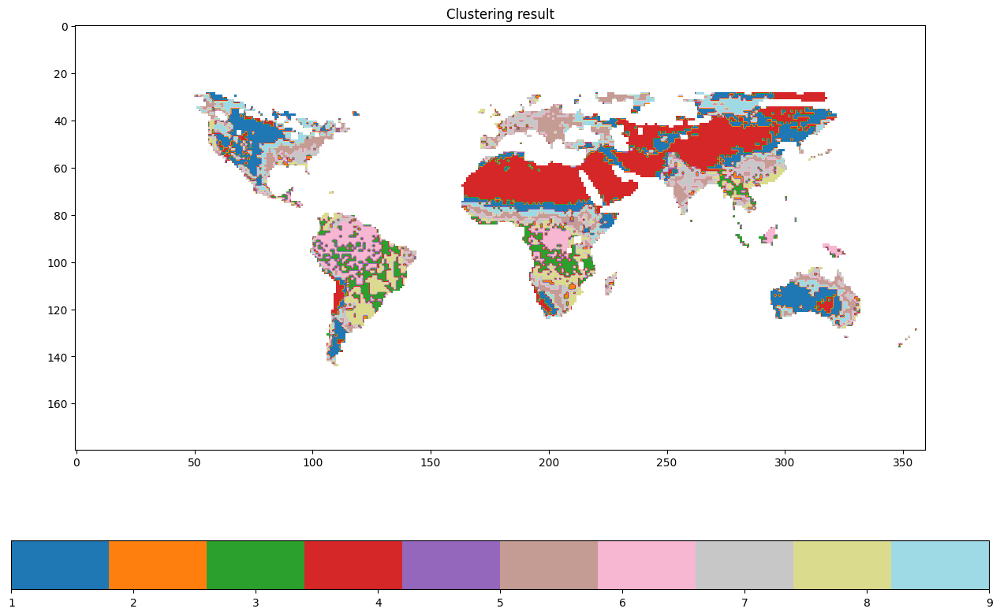

In [32]:
show_results(labels, mask)

In [33]:
df['cluster'] = labels
# Plot the clusters on the map
plot_variable(df, 'cluster', colormap = cm.tab20)

In [14]:
# we try different parameters

clustering_variables = ['DHR443', 'DHR1020', 'NDVI']

data = df[clustering_variables]
data = normalize(data)

# Apply K-means clustering

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(data.fillna(-1000))
labels = kmeans.labels_

df['cluster'] = labels
# Plot the clusters on the map
plot_variable(df, 'cluster', colormap = cm.tab20)

c:\Users\Mathis\.conda\envs\ProjetTunnel\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



## 2. Use Truncated SVD to denoise data

---



VertProfileHeight, Soot_Fraction_F(?), Soluble_Fraction_F, SSAF490, Ross_Li_BRDF_670_volumetric_parameter, Ross_Li_BRDF_670_geometric_parameter, LandBPDFMaignanBreon670, Iron_Fraction_F(?), BrC_Fraction_C(?)

In [15]:
from sklearn.decomposition import TruncatedSVD

n_components = 7 # the number of principal components to keep

added_vars = ['VertProfileHeight', 'SSAF490', 'Iron_Fraction_F', 'Ross_Li_BRDF_670_volumetric_parameter', 'LandBPDFMaignanBreon670']
all_variables = DHR_variables + ['NDVI'] + ['SSAF490', 'Iron_Fraction_F', 'Ross_Li_BRDF_670_volumetric_parameter'] # all variables used for the SVD

data = df[all_variables]


tr = TruncatedSVD(n_components=n_components, random_state=42)
obtained_data = tr.fit_transform(data.fillna(10))
denoised_data = tr.inverse_transform(obtained_data)


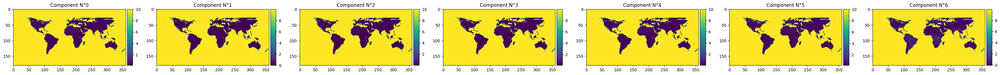

In [16]:
# Plot variables
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, axis_ = plt.subplots(1, n_components, figsize=(5 * n_components, 5))
plt.title('PCA components visualization')

for i, axis in enumerate(axis_):
  im = denoised_data[:, i].reshape(img_shape)
  im = axis.imshow(im, cmap='viridis')

  divider = make_axes_locatable(axis)
  cax = divider.append_axes('right', size='5%', pad=0.05)
  fig.colorbar(im, cax=cax, orientation='vertical')
  axis.set_title('Component N°' + str(i))
plt.tight_layout()
plt.show()

c:\Users\Mathis\.conda\envs\ProjetTunnel\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



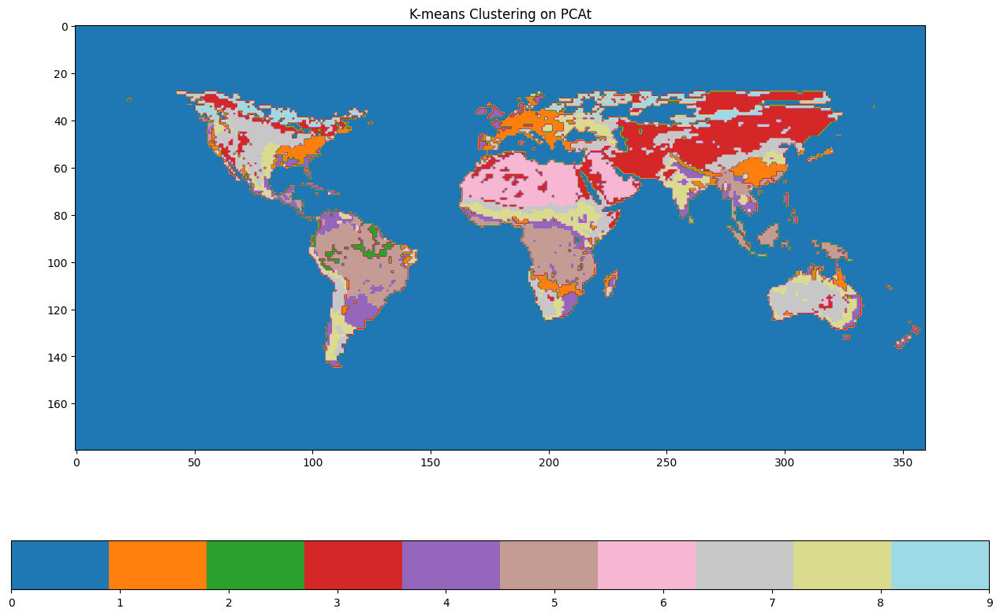

In [17]:
from matplotlib.colors import ListedColormap

num_clusters = 10

# Apply K-means clustering
   # Define the number of clusters
kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(denoised_data)
labels = kmeans.labels_

label_image = labels.reshape(img_shape)

plt.figure(figsize=(16,10))
unique_labels = np.unique(label_image)
n_labels = len(unique_labels)

custom_cmap = ListedColormap(plt.cm.tab20(np.linspace(0, 1, n_labels)))
plt.imshow(label_image, cmap=custom_cmap)
plt.colorbar(orientation='horizontal')
plt.title('K-means Clustering on PCAt')
plt.show()

df['cluster'] = labels
# Plot the clusters on the map
plot_variable(df, 'cluster', colormap = cm.tab20)

## 3. Apply t-SNE to the data to visualize possible land types
[link text](https://www.datacamp.com/tutorial/introduction-t-sne)

## Try to apply different technics of manifold learning
https://scikit-learn.org/stable/modules/manifold.html#spectral-embedding

## 4. Apply HDBSCAN clustering


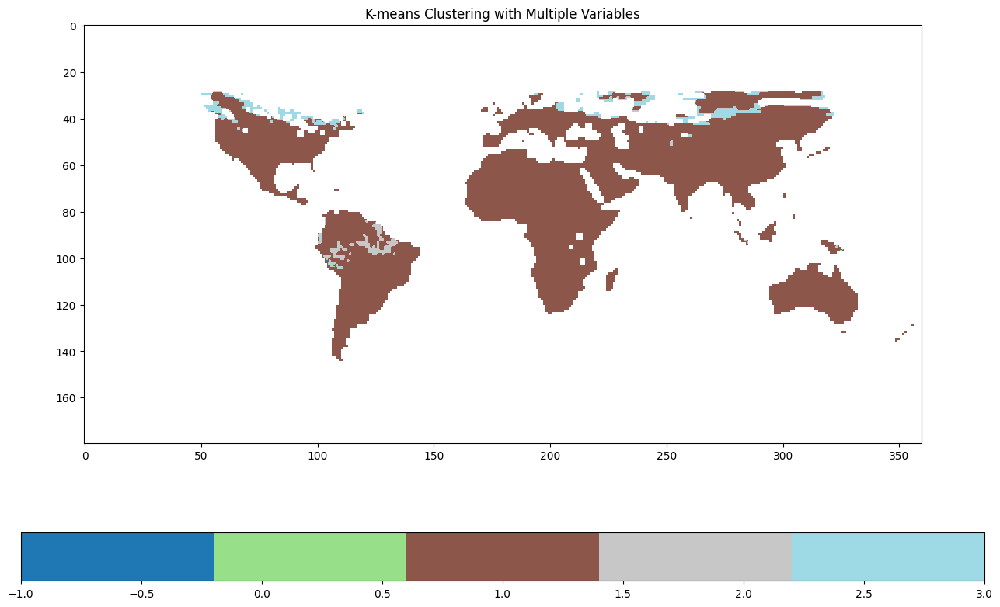

In [ ]:
import hdbscan

clusterer = hdbscan.HDBSCAN(
    min_cluster_size = 100,
    min_samples = 10,
)

clusterer.fit(denoised_data)
labels = clusterer.labels_

show_results(labels)

## 5. HAC Clustering

c:\Users\Mathis\.conda\envs\ProjetTunnel\lib\site-packages\sklearn\cluster\_agglomerative.py:983: FutureWarning:

Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead



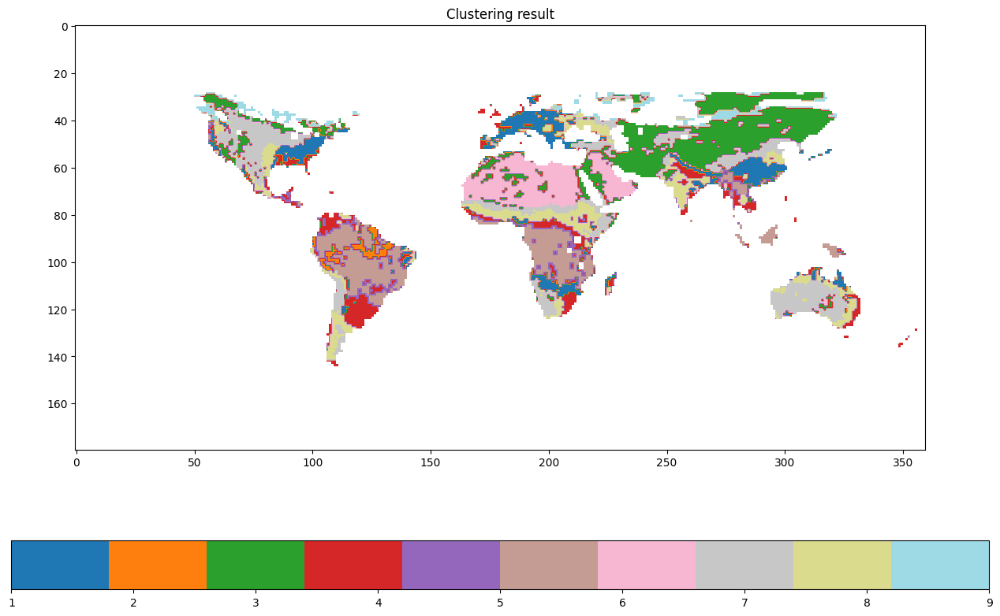

In [29]:
from sklearn.cluster import AgglomerativeClustering # For HAC

hac_ward_model = AgglomerativeClustering(affinity='euclidean', linkage='ward', n_clusters=num_clusters)
hac_ward = hac_ward_model.fit(denoised_data)
labels = kmeans.labels_

df['cluster'] = labels
# Plot the clusters on the map
show_results(labels, mask)
plot_variable(df, 'cluster', colormap = cm.tab20)

In [19]:
from scipy.cluster.hierarchy import dendrogram

def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count
    
    linkage_matrix = np.column_stack([model.children_, model.distances_, counts]).astype(float)
    
    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

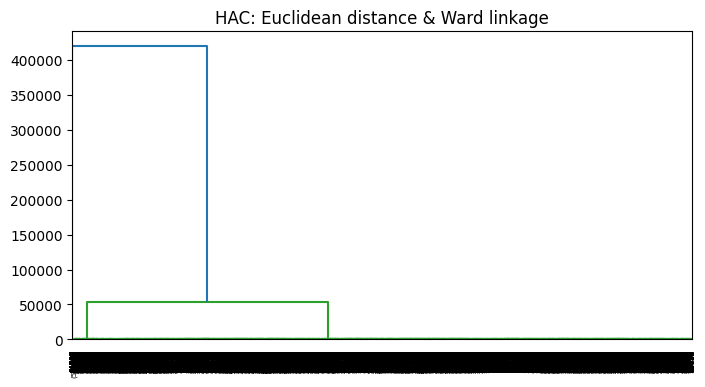

In [20]:
plt.subplots(figsize=(8, 4))
plot_dendrogram(hac_ward, truncate_mode='level')
plt.title('HAC: Euclidean distance & Ward linkage')
plt.show()

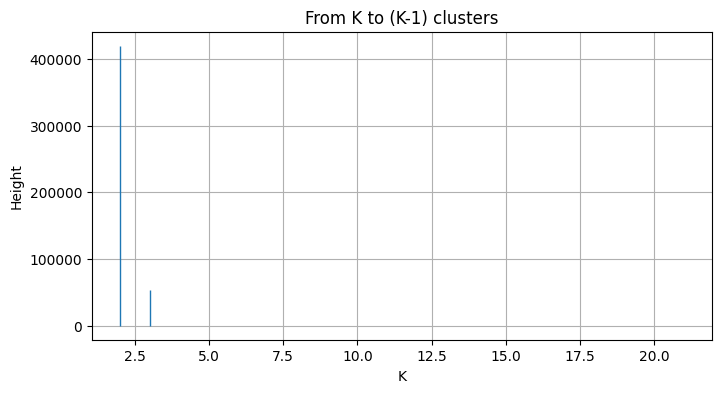

In [26]:
fig, ax = plt.subplots(figsize=(8, 4))
ax.vlines(range(2, 2*num_clusters+2), 0, np.flip(np.sort(hac_ward.distances_))[:2*num_clusters], linewidth=1)
ax.grid()
ax.set_xlabel('K')
ax.set_ylabel('Height')

plt.title('From K to (K-1) clusters')
plt.show()

# TT decomoposition.
Try to find a low-rank approximation using a regular SVD. After that apply TT-decomposition for using reshape of initial images to the shape $2^{d_1} × 2^{d_2} \times 2^{d_3}$, where $d_1,d_2,d_3$ are natural numbers. This is a possible adaptation for satellite images of the approach using in the article "Image Completion with Filtered Low-Rank Tensor Train Approximations" Rafal Zdunek(B), Krzysztof Fonal, and Tomasz Sadowski